In [19]:
import numpy as np
from scipy.spatial import Delaunay
from sklearn.decomposition import PCA
from itertools import combinations
from tqdm import tqdm
import pandas as pd
import os
import pickle
from collections import Counter
from scipy.stats import gaussian_kde


import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import matplotlib.tri as mtri
import matplotlib.cm as cm
matplotlib.rcParams['figure.dpi'] = 360
matplotlib.rcParams['text.usetex'] = True
os.environ['PATH'] = '/Library/TeX/texbin:' + os.environ['PATH']

In [20]:
def rotate_pca_3d(df):
    # use only the real points to calculate the PCA
    coords_real = df[~df['RAN']][['X', 'Y', 'Z']].values

    pca = PCA(n_components=3)
    pca.fit(coords_real)  # only reals define the orientation

    coords_all = df[['X', 'Y', 'Z']].values
    coords_rotated = pca.transform(coords_all)

    df_rot = df.copy()
    df_rot[['PC1', 'PC2', 'PC3']] = coords_rotated
    #df_rot['Angle rotation [°]'] = np.degrees(np.arccos(np.clip(pca.components_[0] @ [0, 0, 1], -1, 1)))

    return df_rot

In [21]:
def compute_r(df):
    coords = df[['X', 'Y', 'Z']].values
    is_data = ~df['RAN'].values

    tri = Delaunay(coords)

    #! adjacency list for neighbors
    neighbors = {i: set() for i in range(len(coords))}
    for simplex in tri.simplices:
        for i, j in combinations(simplex, 2):
            neighbors[i].add(j)
            neighbors[j].add(i)

    r = np.zeros(len(coords), dtype=float)
    for i, nbrs in neighbors.items():
        n_data = int(np.sum(is_data[list(nbrs)]))
        n_rand = len(nbrs) - n_data
        if (n_data + n_rand) > 0:
            r[i] = (n_data - n_rand) / (n_data + n_rand)
        else:
            raise ValueError(f'No neighbors for point {i} in the triangulation.')

    out = df.copy()
    out['r'] = r
    return out

In [22]:
def classify_r(df):
    r = df['r'].values
    conds = [(r >= -1.0) & (r <= -0.9),
             (r > -0.9) & (r <= 0.0),
             (r > 0.0) & (r <= 0.9),
             (r > 0.9) & (r <= 1.0),]
    choices = ['void', 'sheet', 'filament', 'knot']
    df = df.copy()
    df['TYPE'] = np.select(conds, choices, default='error')
    return df

In [7]:
import pandas as pd
import numpy as np
from astropy.table import Table
import os
from tqdm import tqdm
import pickle

# ----------------------
# 🔧 IMPORTA FUNCIONES
# ----------------------

# Asegúrate de tener definidas estas funciones en tu notebook:
# - rotate_pca_3d(df)
# - compute_r(df)
# - classify_r(df)

# ----------------------
# 📁 RUTAS DE ARCHIVOS
# ----------------------

# Datos reales en coordenadas XYZ
base_url_data = '../XYZ_outputs/XYZ_data/'

# Archivos random ya procesados (XYZ)
base_url_rand = './data_100_random/'

# Carpeta donde se guardarán los archivos .pkl individuales por rosetta
save_dir = './typed_by_rosetta/'
os.makedirs(save_dir, exist_ok=True)

# Lista de archivos de datos reales (por rosetta)
data_filenames = [f'{base_url_data}BGS_{i}_clustering_data.ecsv' for i in range(20)]

# ----------------------
# 🚀 PROCESAMIENTO
# ----------------------

for i in tqdm(range(20), desc="Rosettas"):

    # Si ya existe el archivo para esta rosetta, lo saltamos para no repetir
    output_path = os.path.join(save_dir, f'df_typed_rosetta_{i}.pkl')
    if os.path.exists(output_path):
        print(f"⏩ Rosetta {i} ya existe, se omite.")
        continue

    # Leer datos reales
    data_file = data_filenames[i]
    df_real = Table.read(data_file).to_pandas()
    df_real['RAN'] = False
    df_real['ROSETTE_ID'] = i

    # Inicializar lista para almacenar los 100 randoms
    df_typed_randoms = [None for _ in range(100)]

    for j in range(100):
        rand_file = f'{base_url_rand}BGS_{i}clustering_random{j}.ecsv'

        if not os.path.exists(rand_file):
            print(f"⚠  Archivo no encontrado: {rand_file}")
            continue

        df_rand = Table.read(rand_file).to_pandas()
        df_rand['RAN'] = True
        df_rand['ROSETTE_ID'] = i

        # Combinar real + random
        df_combined = pd.concat([df_real, df_rand], ignore_index=True)

        # PCA
        df_rot = rotate_pca_3d(df_combined)

        # Calcular r y clasificar tipo
        df_r = compute_r(df_rot)
        df_typed = classify_r(df_r)

        # Guardar en el slot correspondiente
        df_typed_randoms[j] = df_typed

    # ----------------------
    # 💾 GUARDAR COMO .PKL
    # ----------------------

    with open(output_path, 'wb') as f:
        pickle.dump(df_typed_randoms, f)

    print(f"✅ Guardado: {output_path}")

Rosettas:   5%|███▌                                                                    | 1/20 [02:26<46:32, 146.96s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_0.pkl


Rosettas:  10%|███████▏                                                                | 2/20 [04:59<45:04, 150.24s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_1.pkl


Rosettas:  15%|██████████▊                                                             | 3/20 [07:25<42:02, 148.37s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_2.pkl


Rosettas:  20%|██████████████▍                                                         | 4/20 [09:28<36:55, 138.45s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_3.pkl


Rosettas:  25%|██████████████████                                                      | 5/20 [11:57<35:31, 142.08s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_4.pkl


Rosettas:  30%|█████████████████████▌                                                  | 6/20 [14:05<32:02, 137.34s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_5.pkl


Rosettas:  35%|█████████████████████████▏                                              | 7/20 [15:49<27:24, 126.49s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_6.pkl


Rosettas:  40%|████████████████████████████▊                                           | 8/20 [17:58<25:28, 127.34s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_7.pkl


Rosettas:  45%|████████████████████████████████▍                                       | 9/20 [20:22<24:17, 132.53s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_8.pkl


Rosettas:  50%|███████████████████████████████████▌                                   | 10/20 [22:42<22:26, 134.70s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_9.pkl


Rosettas:  55%|███████████████████████████████████████                                | 11/20 [24:59<20:19, 135.54s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_10.pkl


Rosettas:  60%|██████████████████████████████████████████▌                            | 12/20 [27:29<18:38, 139.86s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_11.pkl


Rosettas:  65%|██████████████████████████████████████████████▏                        | 13/20 [29:24<15:27, 132.44s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_12.pkl


Rosettas:  70%|█████████████████████████████████████████████████▋                     | 14/20 [31:54<13:45, 137.50s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_13.pkl


Rosettas:  75%|█████████████████████████████████████████████████████▎                 | 15/20 [33:50<10:55, 131.19s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_14.pkl


Rosettas:  80%|████████████████████████████████████████████████████████▊              | 16/20 [35:39<08:18, 124.61s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_15.pkl


Rosettas:  85%|████████████████████████████████████████████████████████████▎          | 17/20 [37:57<06:25, 128.62s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_16.pkl


Rosettas:  90%|███████████████████████████████████████████████████████████████▉       | 18/20 [40:13<04:21, 130.68s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_17.pkl


Rosettas:  95%|███████████████████████████████████████████████████████████████████▍   | 19/20 [42:25<02:11, 131.19s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_18.pkl


Rosettas: 100%|███████████████████████████████████████████████████████████████████████| 20/20 [44:15<00:00, 132.78s/it]

✅ Guardado: ./typed_by_rosetta/df_typed_rosetta_19.pkl


In [23]:
import pickle

rosetta_idx = 19 # la que quieras
path = f'typed_by_rosetta/df_typed_rosetta_{rosetta_idx}.pkl'

with open(path, 'rb') as f:
    df_typed = pickle.load(f)

print(f"Rosetta {rosetta_idx} tiene {len(df_typed)} randoms.")
print("Columnas:", df_typed[0].columns)

Rosetta 19 tiene 100 randoms.
Columnas: Index(['TARGETID', 'X', 'Y', 'Z', 'RAN', 'ROSETTE_ID', 'PC1', 'PC2', 'PC3',
       'r', 'TYPE'],
      dtype='object')


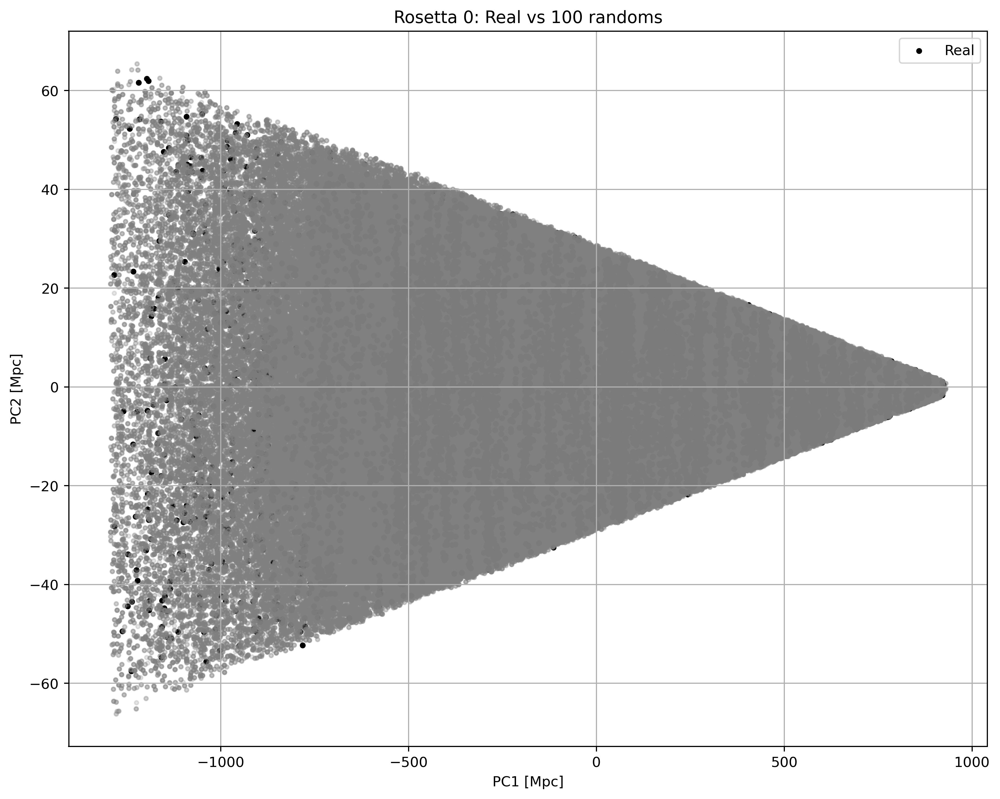

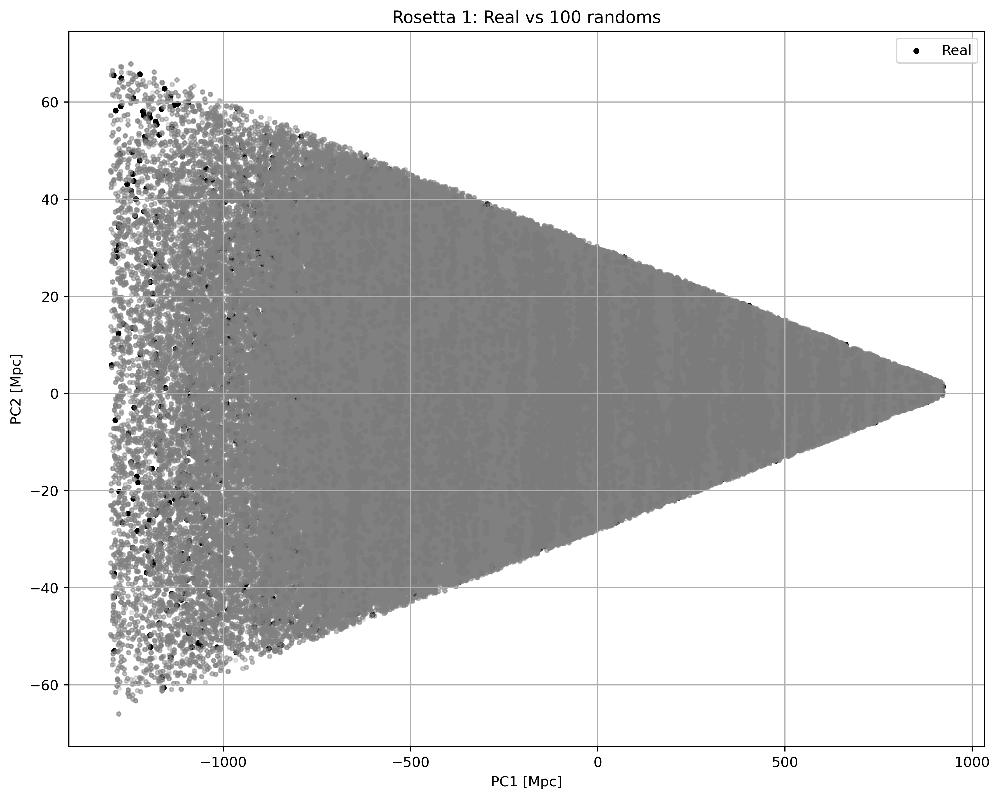

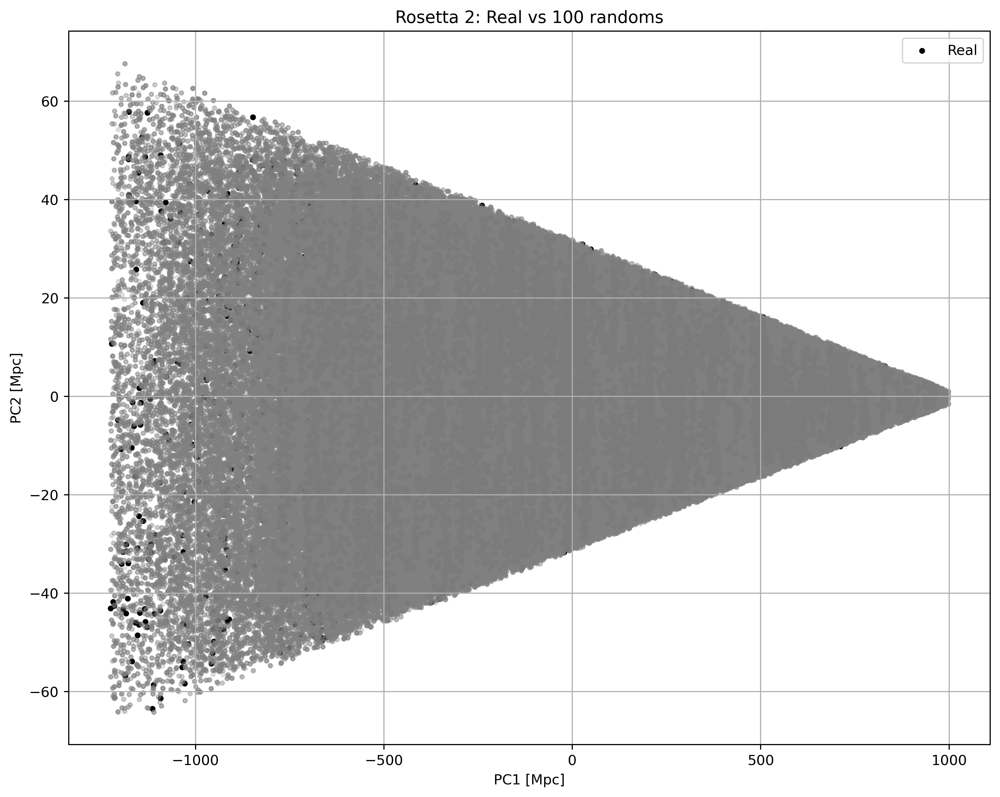

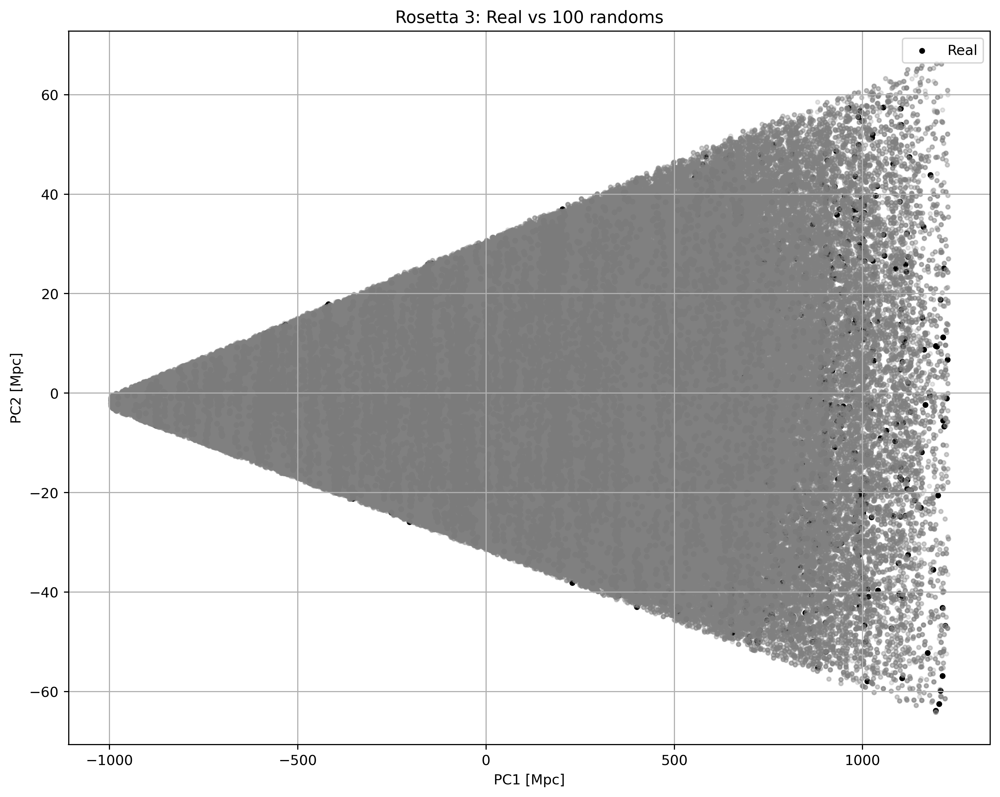

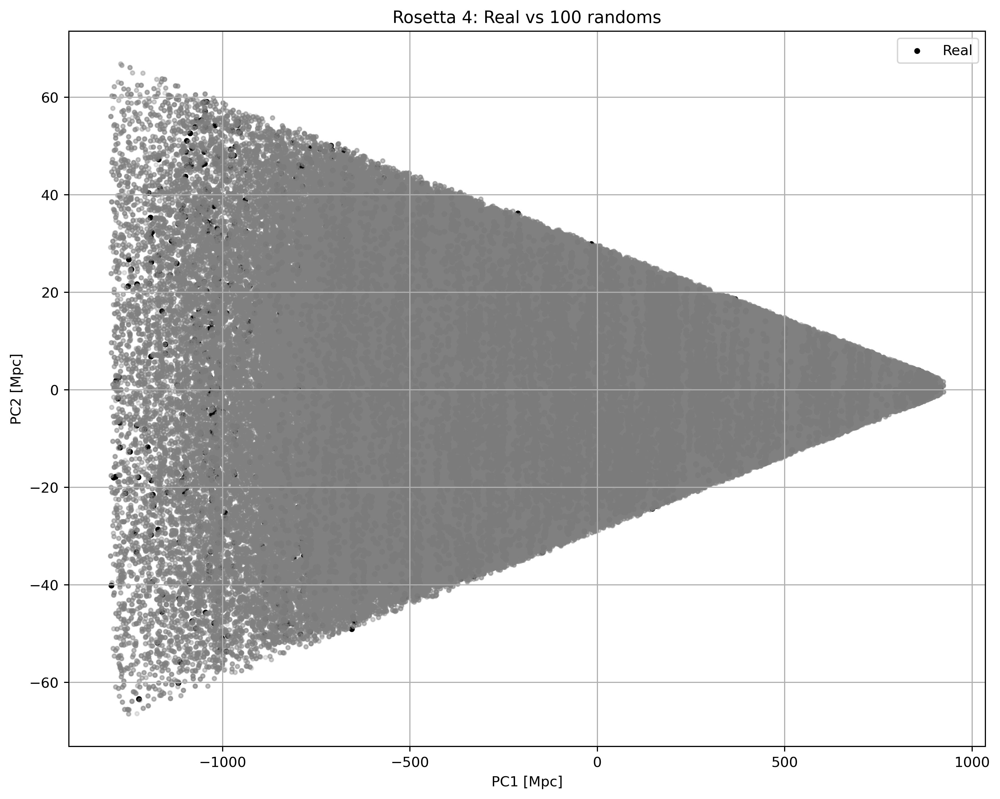

...

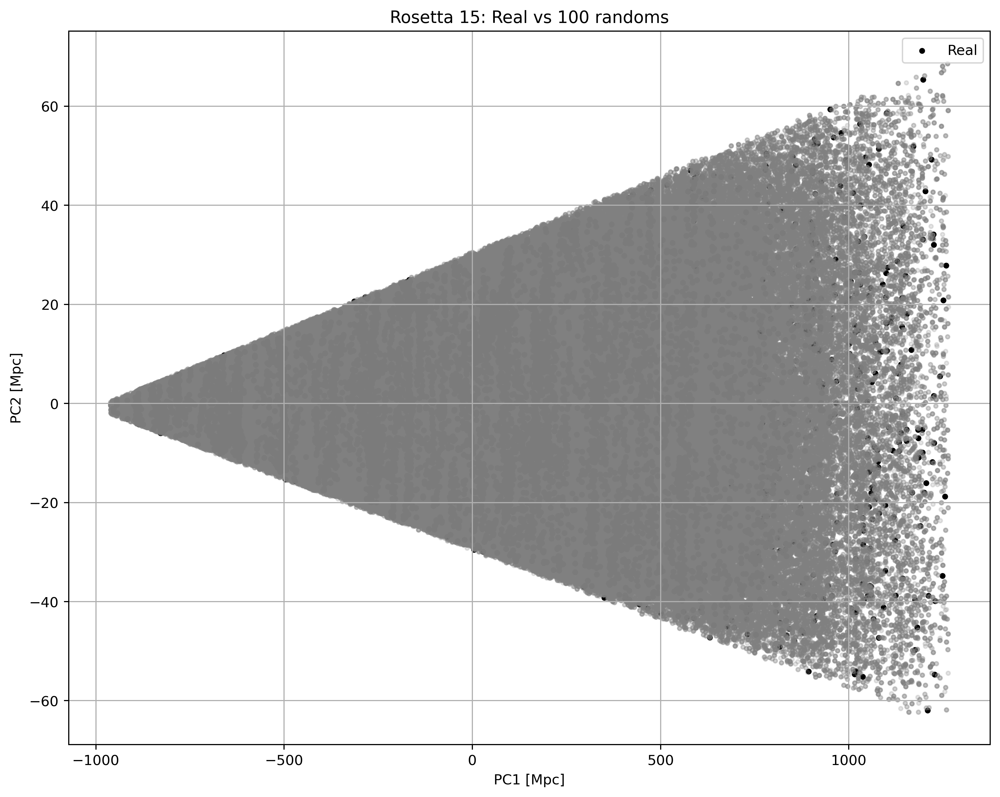

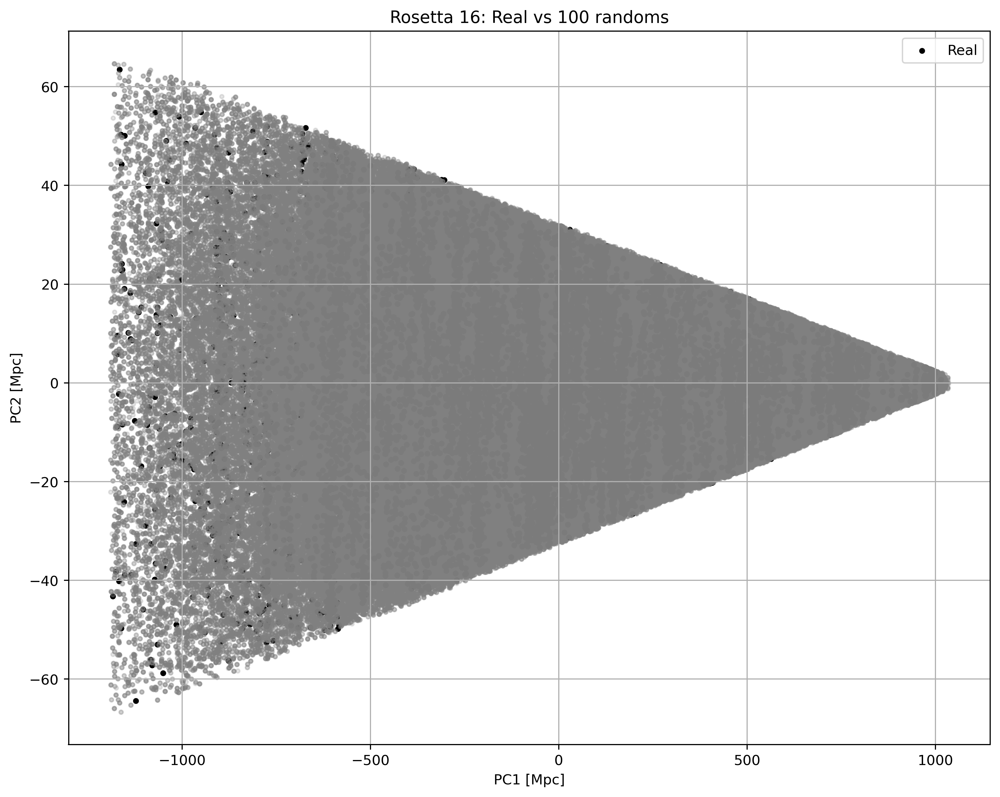

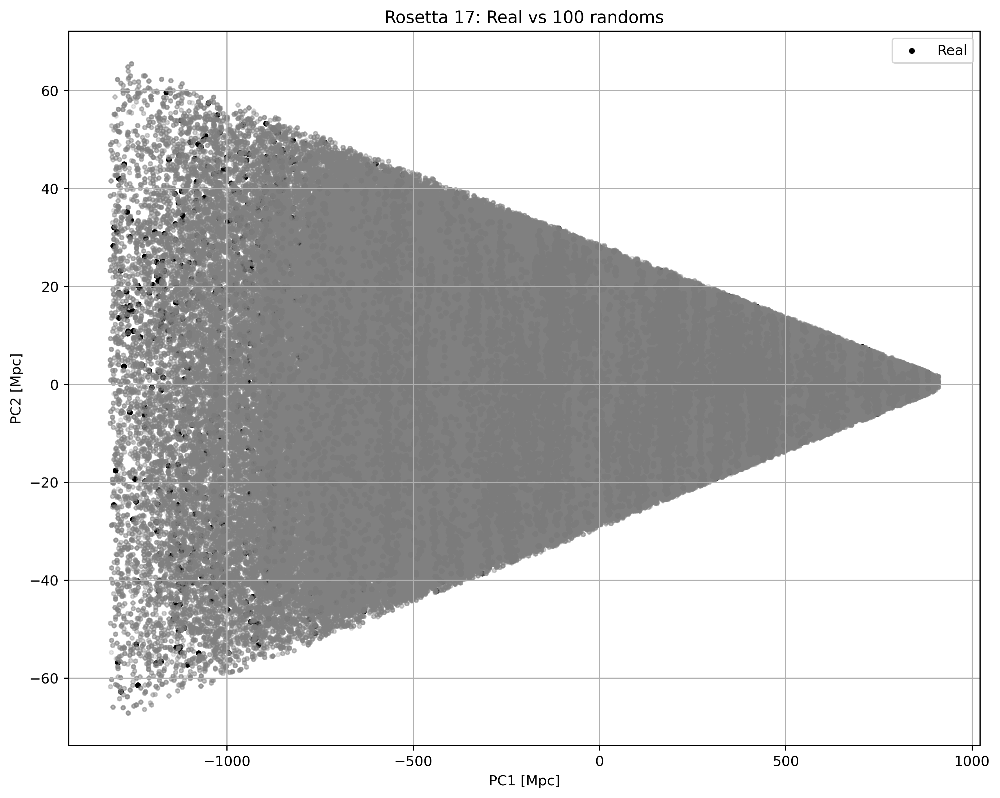

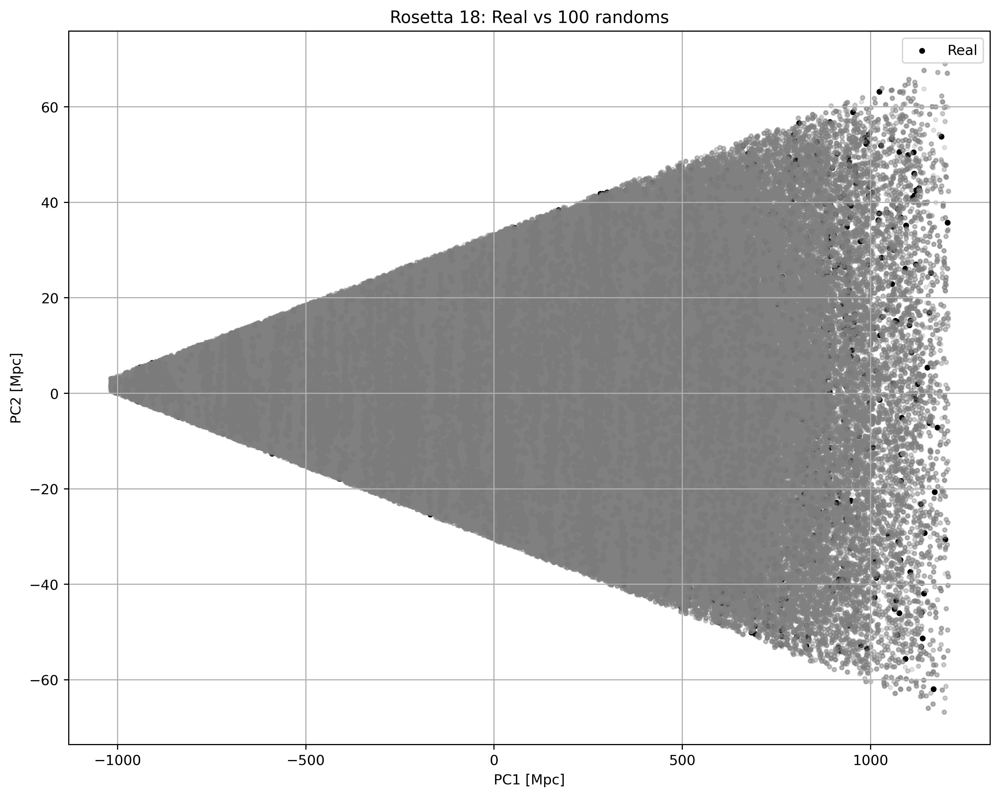

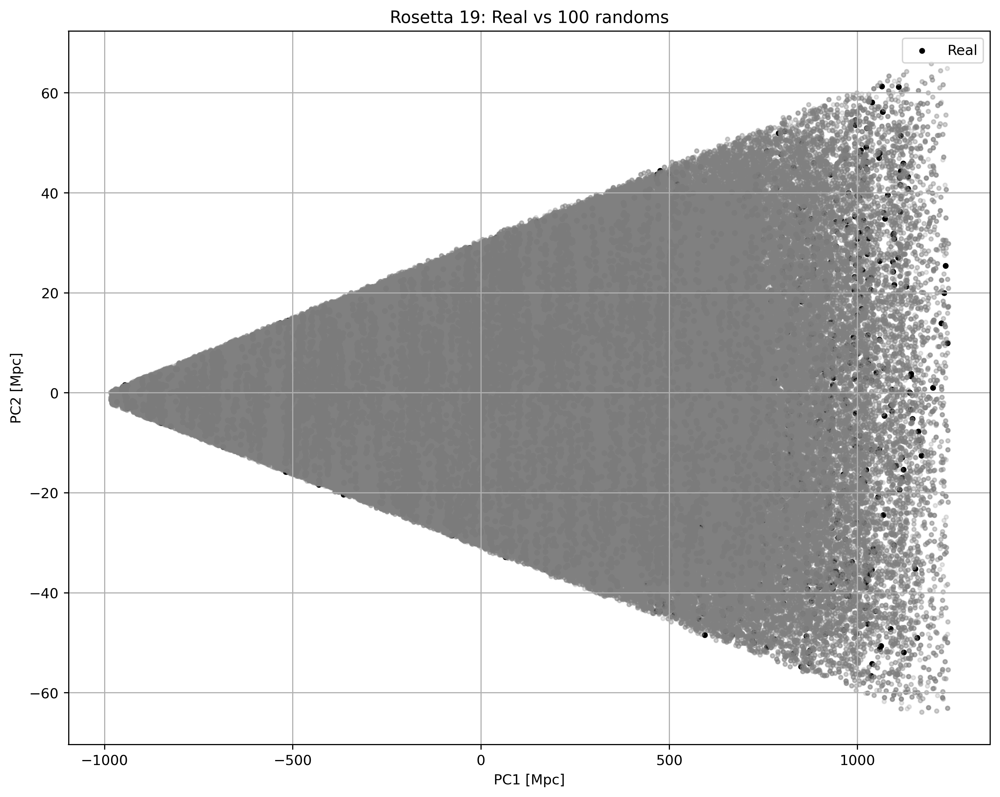

In [15]:
import pickle
import matplotlib.pyplot as plt

for rosetta_idx in range(20):  # o range(1) si quieres probar con una

    # Cargar rosetta desde el archivo correspondiente
    with open(f'typed_by_rosetta/df_typed_rosetta_{rosetta_idx}.pkl', 'rb') as f:
        df_typed_rosetta = pickle.load(f)

    n_randoms_to_plot = 100  # puedes bajar a 10 si sigue lento

    plt.rcParams['text.usetex'] = False
    plt.figure(figsize=(10, 8))

    # Real data
    df_real = df_typed_rosetta[0]  # cualquier j funciona
    df_real = df_real[df_real['RAN'] == False]
    plt.scatter(df_real['PC1'], df_real['PC2'], color='black', label='Real', s=10)

    # Randoms
    for j in range(n_randoms_to_plot):
        df_rand = df_typed_rosetta[j]
        if df_rand is not None:
            df_rand = df_rand[df_rand['RAN'] == True]
            plt.scatter(df_rand['PC1'], df_rand['PC2'], alpha=0.2, s=8, color='gray')
    plt.rcParams['text.usetex'] = False
    
    plt.xlabel('PC1 [Mpc]')
    plt.ylabel('PC2 [Mpc]')
    plt.title(f'Rosetta {rosetta_idx}: Real vs {n_randoms_to_plot} randoms')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    

In [25]:
import pickle
import numpy as np

structure_types = ['void', 'sheet', 'filament', 'knot']

# Diccionarios para guardar fracciones
data_fractions = {i: {t: [] for t in structure_types} for i in range(20)}
rand_fractions = {i: {t: [] for t in structure_types} for i in range(20)}

for i in range(20):  # Rosettas
    with open(f'typed_by_rosetta/df_typed_rosetta_{i}.pkl', 'rb') as f:
        df_typed_rosetta = pickle.load(f)  # Lista de 100 DataFrames

    for j in range(100):
        df = df_typed_rosetta[j]

        for source, container in [(False, data_fractions), (True, rand_fractions)]:
            df_sub = df[df['RAN'] == source]
            total = len(df_sub)

            for t in structure_types:
                count = np.sum(df_sub['TYPE'] == t)
                frac = count / total if total > 0 else 0.0
                container[i][t].append(frac)

print(" Fracciones por tipo calculadas usando los pkl por rosetta.")

✅ Fracciones por tipo calculadas usando los pkl por rosetta.


In [27]:
dfs_by_rosetta = []

for i in range(20):
    rosetta_rows = []
    rosetta_labels = []

    for label, container in [(f"Rosetta {i} data", data_fractions),
                             (f"Rosetta {i} rand", rand_fractions)]:
        row = []
        for t in structure_types:
            fracs = container[i][t]
            if len(fracs) == 0:
                mean_frac = 0.0
                std_frac = 0.0
            else:
                mean_frac = np.mean(fracs)
                std_frac = np.std(fracs, ddof=1)

            row.append(f"{mean_frac*100:.2f}% ± {std_frac*100:.2f}%")

        rosetta_rows.append(row)
        rosetta_labels.append(label)

    df_rosetta = pd.DataFrame(rosetta_rows,
                              columns=['Voids', 'Sheets', 'Filaments', 'Knots'],
                              index=rosetta_labels)
    dfs_by_rosetta.append(df_rosetta)

In [28]:
for i, rosetta_df in enumerate(dfs_by_rosetta):
    print(f"\nRosetta {i}")
    display(rosetta_df)


Rosetta 0


,Voids,Sheets,Filaments,Knots
Rosetta 0 data,0.35% ± 0.04%,31.91% ± 0.42%,62.65% ± 0.56%,5.08% ± 0.32%
Rosetta 0 rand,9.41% ± 0.30%,69.29% ± 0.50%,21.04% ± 0.34%,0.26% ± 0.04%



Rosetta 1


,Voids,Sheets,Filaments,Knots
Rosetta 1 data,0.33% ± 0.04%,31.91% ± 0.32%,63.00% ± 0.46%,4.75% ± 0.30%
Rosetta 1 rand,9.35% ± 0.26%,69.19% ± 0.38%,21.21% ± 0.28%,0.25% ± 0.04%



Rosetta 2


,Voids,Sheets,Filaments,Knots
Rosetta 2 data,0.30% ± 0.04%,32.62% ± 0.38%,63.48% ± 0.39%,3.60% ± 0.21%
Rosetta 2 rand,9.11% ± 0.30%,68.42% ± 0.44%,22.28% ± 0.29%,0.19% ± 0.04%



Rosetta 3


,Voids,Sheets,Filaments,Knots
Rosetta 3 data,0.33% ± 0.05%,34.23% ± 0.36%,61.06% ± 0.42%,4.37% ± 0.27%
Rosetta 3 rand,6.45% ± 0.26%,71.88% ± 0.41%,21.45% ± 0.32%,0.22% ± 0.05%



Rosetta 4


,Voids,Sheets,Filaments,Knots
Rosetta 4 data,0.33% ± 0.04%,32.42% ± 0.30%,61.56% ± 0.38%,5.69% ± 0.28%
Rosetta 4 rand,9.78% ± 0.27%,69.40% ± 0.47%,20.54% ± 0.35%,0.28% ± 0.05%



Rosetta 5


,Voids,Sheets,Filaments,Knots
Rosetta 5 data,0.34% ± 0.05%,32.16% ± 0.37%,62.57% ± 0.49%,4.94% ± 0.29%
Rosetta 5 rand,8.03% ± 0.25%,71.36% ± 0.34%,20.36% ± 0.26%,0.26% ± 0.05%



Rosetta 6


,Voids,Sheets,Filaments,Knots
Rosetta 6 data,0.31% ± 0.05%,34.40% ± 0.44%,61.06% ± 0.55%,4.22% ± 0.30%
Rosetta 6 rand,7.36% ± 0.38%,70.63% ± 0.57%,21.81% ± 0.40%,0.20% ± 0.04%



Rosetta 7


,Voids,Sheets,Filaments,Knots
Rosetta 7 data,0.36% ± 0.05%,33.76% ± 0.35%,62.09% ± 0.46%,3.80% ± 0.28%
Rosetta 7 rand,6.98% ± 0.28%,70.88% ± 0.39%,21.94% ± 0.30%,0.20% ± 0.04%



Rosetta 8


,Voids,Sheets,Filaments,Knots
Rosetta 8 data,0.27% ± 0.04%,34.30% ± 0.36%,61.73% ± 0.43%,3.69% ± 0.26%
Rosetta 8 rand,7.07% ± 0.29%,71.00% ± 0.41%,21.75% ± 0.32%,0.18% ± 0.04%



Rosetta 9


,Voids,Sheets,Filaments,Knots
Rosetta 9 data,0.28% ± 0.04%,32.71% ± 0.34%,62.38% ± 0.44%,4.63% ± 0.27%
Rosetta 9 rand,8.41% ± 0.29%,70.46% ± 0.38%,20.88% ± 0.29%,0.26% ± 0.05%



Rosetta 10


,Voids,Sheets,Filaments,Knots
Rosetta 10 data,0.30% ± 0.04%,33.89% ± 0.44%,62.00% ± 0.42%,3.81% ± 0.25%
Rosetta 10 rand,7.81% ± 0.30%,70.09% ± 0.42%,21.87% ± 0.30%,0.22% ± 0.04%



Rosetta 11


,Voids,Sheets,Filaments,Knots
Rosetta 11 data,0.36% ± 0.05%,33.43% ± 0.39%,61.96% ± 0.48%,4.25% ± 0.25%
Rosetta 11 rand,6.96% ± 0.23%,71.62% ± 0.34%,21.21% ± 0.28%,0.21% ± 0.05%



Rosetta 12


,Voids,Sheets,Filaments,Knots
Rosetta 12 data,0.33% ± 0.04%,33.58% ± 0.46%,62.84% ± 0.45%,3.25% ± 0.23%
Rosetta 12 rand,6.46% ± 0.27%,71.27% ± 0.46%,22.10% ± 0.36%,0.17% ± 0.04%



Rosetta 13


,Voids,Sheets,Filaments,Knots
Rosetta 13 data,0.34% ± 0.04%,32.49% ± 0.40%,62.34% ± 0.45%,4.83% ± 0.32%
Rosetta 13 rand,7.84% ± 0.29%,71.41% ± 0.41%,20.46% ± 0.30%,0.30% ± 0.04%



Rosetta 14


,Voids,Sheets,Filaments,Knots
Rosetta 14 data,0.28% ± 0.04%,33.75% ± 0.40%,61.59% ± 0.50%,4.38% ± 0.33%
Rosetta 14 rand,6.99% ± 0.28%,71.44% ± 0.41%,21.34% ± 0.29%,0.23% ± 0.04%



Rosetta 15


,Voids,Sheets,Filaments,Knots
Rosetta 15 data,0.32% ± 0.04%,34.76% ± 0.44%,60.15% ± 0.51%,4.77% ± 0.28%
Rosetta 15 rand,7.12% ± 0.27%,71.65% ± 0.45%,20.99% ± 0.38%,0.24% ± 0.05%



Rosetta 16


,Voids,Sheets,Filaments,Knots
Rosetta 16 data,0.30% ± 0.04%,32.70% ± 0.33%,62.27% ± 0.41%,4.73% ± 0.31%
Rosetta 16 rand,7.85% ± 0.26%,70.78% ± 0.37%,21.12% ± 0.31%,0.25% ± 0.04%



Rosetta 17


,Voids,Sheets,Filaments,Knots
Rosetta 17 data,0.34% ± 0.05%,33.44% ± 0.30%,61.17% ± 0.50%,5.04% ± 0.36%
Rosetta 17 rand,7.95% ± 0.28%,71.24% ± 0.41%,20.55% ± 0.33%,0.26% ± 0.04%



Rosetta 18


,Voids,Sheets,Filaments,Knots
Rosetta 18 data,0.35% ± 0.04%,32.87% ± 0.39%,63.24% ± 0.42%,3.54% ± 0.25%
Rosetta 18 rand,8.53% ± 0.30%,68.40% ± 0.47%,22.88% ± 0.34%,0.19% ± 0.04%



Rosetta 19


,Voids,Sheets,Filaments,Knots
Rosetta 19 data,0.26% ± 0.04%,34.05% ± 0.39%,61.61% ± 0.51%,4.09% ± 0.34%
Rosetta 19 rand,7.32% ± 0.34%,70.86% ± 0.45%,21.62% ± 0.33%,0.20% ± 0.04%


In [29]:
type_to_index = {t: i for i, t in enumerate(structure_types)}
type_to_index

{'void': 0, 'sheet': 1, 'filament': 2, 'knot': 3}

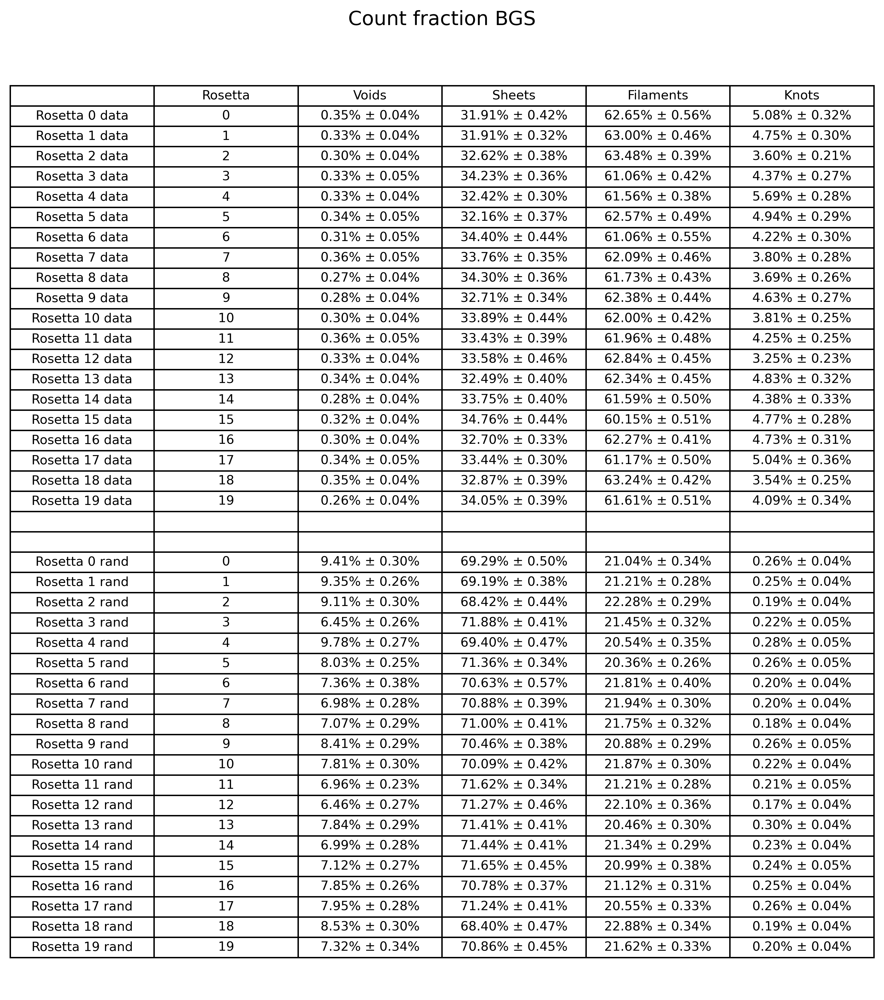

In [58]:
import pandas as pd
import matplotlib.pyplot as plt

# Suponiendo que dfs_by_rosetta ya existe

# Crear lista para la tabla general (sin guardar imagen aún)
general_table_rows = []

# Primera parte: datos reales
for i in range(20):
    row = dfs_by_rosetta[i].iloc[0].values
    general_table_rows.append([f"Rosetta {i} data", i] + list(row))

# Agregar filas vacías
general_table_rows.append(["", ""] + [""] * 4)
general_table_rows.append(["", ""] + [""] * 4)

# Segunda parte: datos random
for i in range(20):
    row = dfs_by_rosetta[i].iloc[1].values
    general_table_rows.append([f"Rosetta {i} rand", i] + list(row))

# Crear DataFrame final
df_general = pd.DataFrame(general_table_rows,
                          columns=['', 'Rosetta', 'Voids', 'Sheets', 'Filaments', 'Knots'])

# Mostrar como tabla matplotlib
fig, ax = plt.subplots(figsize=(10, 12))  # Puedes ajustar tamaño

table = ax.table(cellText=df_general.values,
                 colLabels=df_general.columns,
                 loc='center',
                 cellLoc='center')

table.set_fontsize(9)      # Tamaño de fuente
table.scale(1.1, 1.2)      # Ajuste de tamaño horizontal y vertical

ax.axis('off')
plt.title("Count fraction BGS", fontsize=14, pad=20)
plt.show()

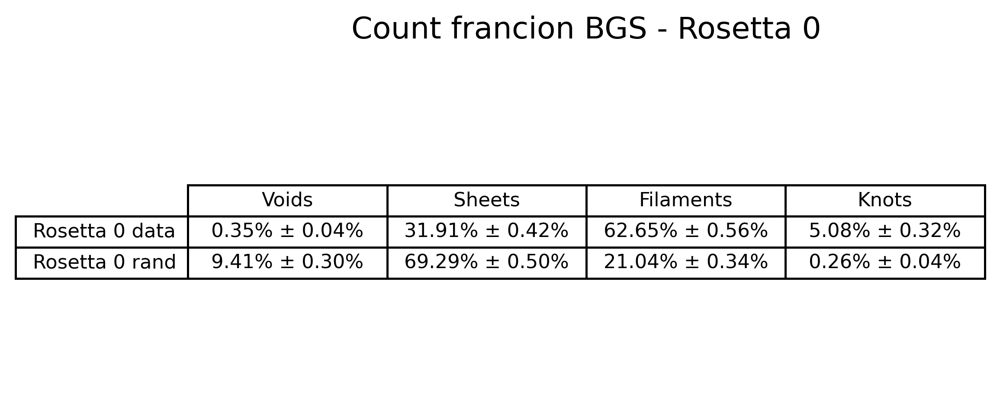

In [54]:
import matplotlib.pyplot as plt

# Rosetta específica que quieres mostrar
rosetta_id = 0  # cámbialo si quieres otra

# Obtener DataFrame correspondiente
df = dfs_by_rosetta[rosetta_id]

# Mostrar tabla con matplotlib
fig, ax = plt.subplots(figsize=(6, 2.5))  # Ajusta tamaño si se corta

table = ax.table(cellText=df.values,
                 rowLabels=df.index,
                 colLabels=df.columns,
                 loc='center',
                 cellLoc='center')

table.set_fontsize(10)    # Tamaño de letra de la tabla
table.scale(1.1, 1.2)     # Ajuste de escala de tabla

ax.axis('off')
plt.title(f"Count francion BGS - Rosetta {rosetta_id}", fontsize=14, pad=20)
plt.show()

In [50]:
import numpy as np
import pandas as pd
import pickle
from tqdm import tqdm

# Estructura para guardar los resultados de entropía
entropy_per_rosetta = []

# Diccionario para mapear tipo → índice
type_to_index = {'void': 0, 'sheet': 1, 'filament': 2, 'knot': 3}

for i in tqdm(range(20), desc="Calculando entropía por rosetta"):

    # Cargar el archivo .pkl de esta rosetta
    with open(f'./typed_by_rosetta/df_typed_rosetta_{i}.pkl', 'rb') as f:
        df_typed_list = pickle.load(f)

    # Obtener el dataframe real (el real es el mismo en todos los j)
    df_real = df_typed_list[0]
    df_real = df_real[df_real['RAN'] == False].copy()
    n_points = len(df_real)

    # Crear matriz de conteo: filas = puntos reales, columnas = tipos
    counts = np.zeros((n_points, 4), dtype=int)

    for j in range(100):
        df_j = df_typed_list[j]
        if df_j is None:
            continue

        df_j_real = df_j[df_j['RAN'] == False].reset_index(drop=True)
        types_j = df_j_real['TYPE'].values

        for idx, t in enumerate(types_j):
            if t in type_to_index:
                t_idx = type_to_index[t]
                counts[idx, t_idx] += 1

    # Calcular entropía para cada punto real
    entropy_list = []
    for idx in range(n_points):
        total = counts[idx].sum()
        p_w = counts[idx] / total if total > 0 else np.zeros(4)
        entropy = -np.sum(p_w[p_w > 0] * np.log2(p_w[p_w > 0])) / np.log2(4)

        point = df_real.iloc[idx]
        entropy_list.append({
            'TARGETID': point['TARGETID'],
            'ROSETTE_ID': i,
            'ENTROPY': entropy
        })

    # Guardar los resultados de esta rosetta
    entropy_df = pd.DataFrame(entropy_list)
    entropy_per_rosetta.append(entropy_df)

Calculando entropía por rosetta: 100%|█████████████████████████████████████████████████| 20/20 [00:45<00:00,  2.30s/it]


In [51]:
entropy_per_rosetta[8]

,TARGETID,ROSETTE_ID,ENTROPY
0,39627800453321595,8,0.234498
1,39627806493117457,8,0.182962
2,39627800457513387,8,0.370741
3,39627776302518867,8,0.163722
4,39627806480538230,8,0.040397
...,...,...,...
13051,39627734002959514,8,0.182962
13052,39627733990377311,8,0.040397
13053,39627734011347241,8,-0.000000
13054,39627740051145816,8,0.070720


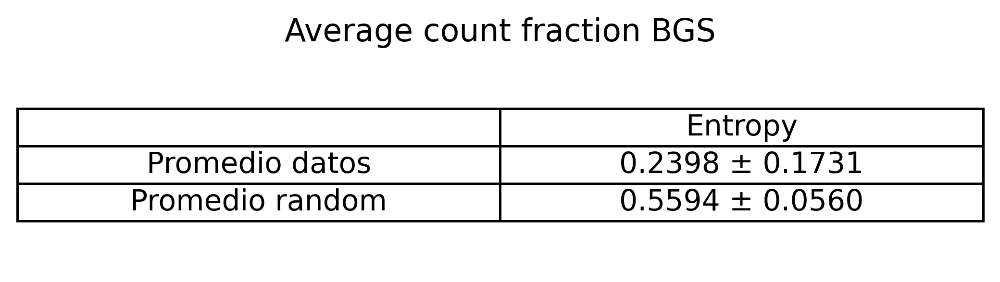

In [81]:
# Inicializar listas para entropía real y random
entropy_real = []
entropy_random = []

# Recorrer los archivos de nuevo para extraer random también
for i in range(20):
    with open(f'./typed_by_rosetta/df_typed_rosetta_{i}.pkl', 'rb') as f:
        df_typed_list = pickle.load(f)

    # Datos reales
    df_real = df_typed_list[0]
    df_real = df_real[df_real['RAN'] == False].copy()
    n_points = len(df_real)
    counts_real = np.zeros((n_points, 4), dtype=int)

    for j in range(100):
        df_j = df_typed_list[j]
        if df_j is None:
            continue
        df_j_real = df_j[df_j['RAN'] == False].reset_index(drop=True)
        for idx, t in enumerate(df_j_real['TYPE'].values):
            if t in type_to_index:
                counts_real[idx, type_to_index[t]] += 1

    for idx in range(n_points):
        total = counts_real[idx].sum()
        p_w = counts_real[idx] / total if total > 0 else np.zeros(4)
        entropy = -np.sum(p_w[p_w > 0] * np.log2(p_w[p_w > 0])) / np.log2(4)
        entropy_real.append(entropy)

    # Datos random (de la misma manera)
    df_random = df_typed_list[0]
    df_random = df_random[df_random['RAN'] == True].copy()
    n_points_rand = len(df_random)
    counts_rand = np.zeros((n_points_rand, 4), dtype=int)

    for j in range(100):
        df_j = df_typed_list[j]
        if df_j is None:
            continue
        df_j_rand = df_j[df_j['RAN'] == True].reset_index(drop=True)
        for idx, t in enumerate(df_j_rand['TYPE'].values):
            if t in type_to_index:
                counts_rand[idx, type_to_index[t]] += 1

    for idx in range(n_points_rand):
        total = counts_rand[idx].sum()
        p_w = counts_rand[idx] / total if total > 0 else np.zeros(4)
        entropy = -np.sum(p_w[p_w > 0] * np.log2(p_w[p_w > 0])) / np.log2(4)
        entropy_random.append(entropy)

# Calcular estadísticas finales
mean_real = np.mean(entropy_real)
std_real = np.std(entropy_real)

mean_rand = np.mean(entropy_random)
std_rand = np.std(entropy_random)

# Crear DataFrame resumen
df_entropy_summary_total = pd.DataFrame([
    ["Promedio datos", f"{mean_real:.4f} ± {std_real:.4f}"],
    ["Promedio random", f"{mean_rand:.4f} ± {std_rand:.4f}"]
], columns=["", "Entropy"])

# Guardar como CSV y PNG
out_dir = "desktop/CosmicWeb_BGS_ASTRA/07_resultados_100_random_vs_datos/entropia"
os.makedirs(out_dir, exist_ok=True)

df_entropy_summary_total.to_csv(f"{out_dir}/resumen_promedios_totales_entropia.csv", index=False)

# Imagen
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(6, 1.5))
table = ax.table(cellText=df_entropy_summary_total.values,
                 colLabels=df_entropy_summary_total.columns,
                 loc='center',
                 cellLoc='center')

table.set_fontsize(12)
table.scale(1.2, 1.3)

ax.axis('off')
plt.title("Average count fraction BGS", fontsize=13, pad=10)
#plt.savefig(f"{out_dir}/resumen_promedios_totales_entropia.png", dpi=300, bbox_inches='tight')
plt.show()


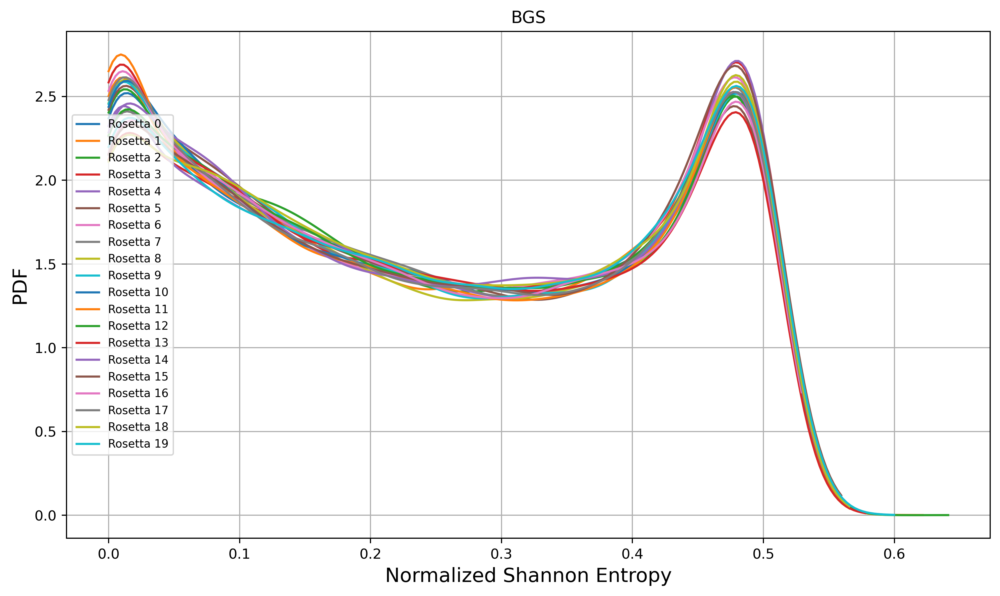

In [65]:
import os
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import numpy as np

# Ruta de guardado
plot_dir = "desktop/CosmicWeb_BGS_ASTRA/07_resultados_100_random_vs_datos/100_random_plots"
os.makedirs(plot_dir, exist_ok=True)  # Asegura que exista la carpeta

# Crear figura
plt.figure(figsize=(10, 6))

for i in range(20):
    entropy_values = entropy_per_rosetta[i]['ENTROPY']

    kde = gaussian_kde(entropy_values)
    x_vals = np.linspace(min(entropy_values), max(entropy_values), 200)
    pdf_vals = kde(x_vals)

    plt.plot(x_vals, pdf_vals, label=f'Rosetta {i}')

plt.xlabel("Normalized Shannon Entropy", fontsize=14)
plt.ylabel("PDF", fontsize=14)
plt.title("BGS")
plt.grid(True)
plt.legend(loc='center left', fontsize=8)
plt.tight_layout()

# Guardar ANTES de mostrar
plt.savefig(f"{plot_dir}/BGS_PDF_vs_entropy_smooth_wlegend.png", dpi=300, bbox_inches='tight')
plt.show()

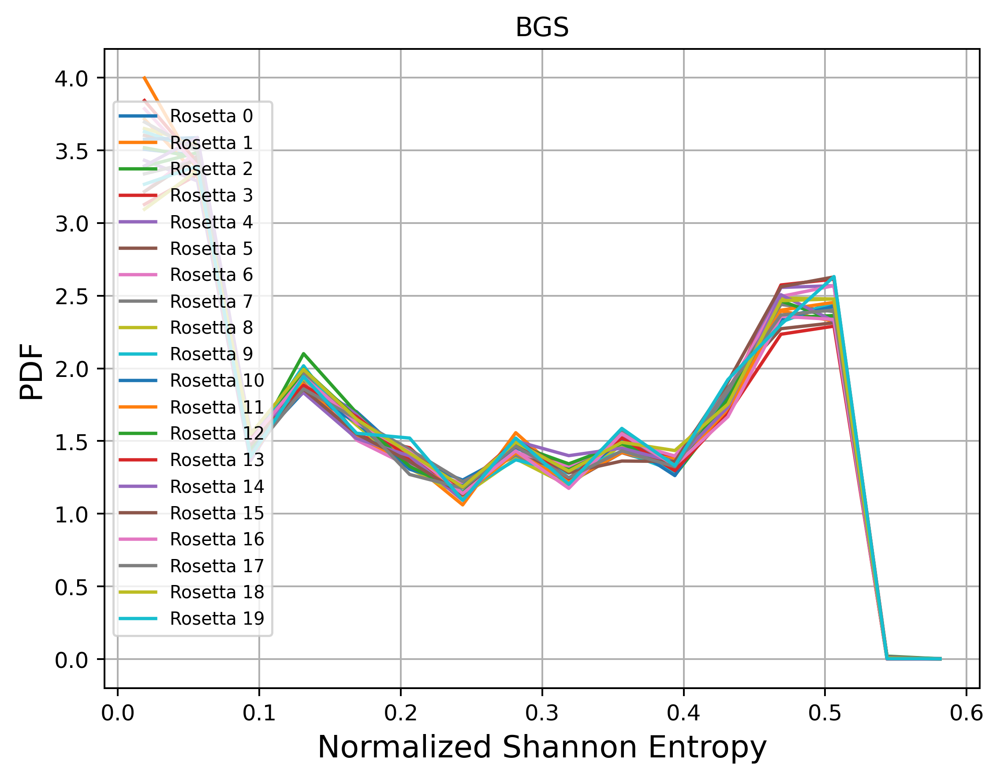

In [82]:
plot_dir = "desktop/CosmicWeb_BGS_ASTRA/07_resultados_100_random_vs_datos/100_random_plots"
os.makedirs(plot_dir, exist_ok=True)  # Asegura que exista la carpeta

for i in range(20):
    df = entropy_per_rosetta[i]
    entropy_values = df['ENTROPY'].dropna()

    hist, bin_edges = np.histogram(entropy_values, bins=16, range=(0, 0.6), density=True)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    plt.plot(bin_centers, hist, label=f'Rosetta {i}', linewidth=1.5)
    plt.xlabel("Normalized Shannon Entropy", fontsize=14)
    plt.ylabel("PDF", fontsize=14)
    plt.grid(True)
    plt.legend(loc='center left', fontsize=8)
    plt.tight_layout()

plt.title("BGS")
#plt.savefig(f"{plot_dir}/BGS_PDF_vs_entropy_straight_wolegend.png", dpi=300, bbox_inches='tight')
plt.show()

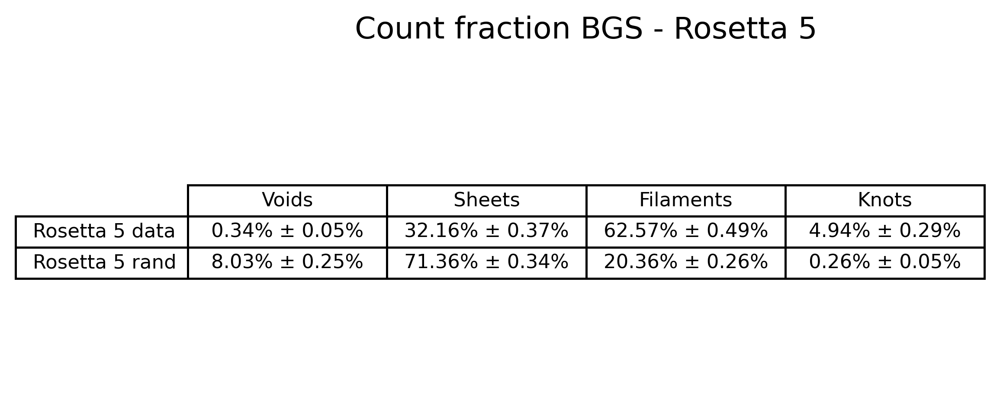

In [88]:
import os
import matplotlib.pyplot as plt

# Rosetta específica
rosetta_id = 6  # Cambia el número si quieres otra

# Crear carpeta si no existe
out_dir = "desktop/CosmicWeb_BGS_ASTRA/07_resultados_100_random_vs_datos/100_random_tablas/individuales_por_rosetta"
os.makedirs(out_dir, exist_ok=True)

# Obtener DataFrame de esa Rosetta
df = dfs_by_rosetta[rosetta_id]

# Guardar CSV editable
df.to_csv(f"{out_dir}/rosetta_{rosetta_id}_tabla.csv")

# Mostrar y guardar como imagen PNG
fig, ax = plt.subplots(figsize=(6, 2.5))
table = ax.table(cellText=df.values,
                 rowLabels=df.index,
                 colLabels=df.columns,
                 loc='center',
                 cellLoc='center')

table.set_fontsize(10)
table.scale(1.1, 1.2)

ax.axis('off')
plt.title(f"Count fraction BGS - Rosetta {rosetta_id}", fontsize=14, pad=20)
plt.savefig(f"{out_dir}/rosetta_{rosetta_id}_tabla.png", dpi=300, bbox_inches='tight')
plt.show()

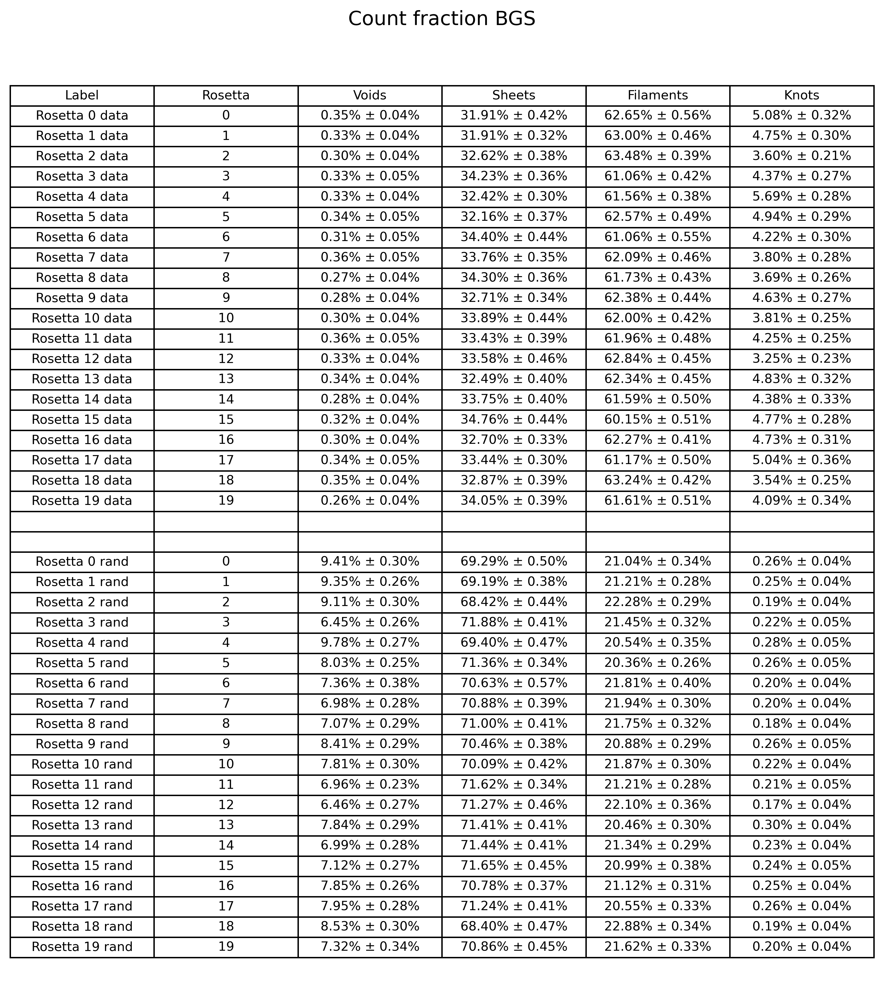

In [70]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Crear carpeta si no existe
out_dir = "desktop/CosmicWeb_BGS_ASTRA/07_resultados_100_random_vs_datos/100_random_tablas/general"
os.makedirs(out_dir, exist_ok=True)

# Construir tabla general
general_table_rows = []

# Parte superior: datos reales
for i in range(20):
    row = dfs_by_rosetta[i].iloc[0].values
    general_table_rows.append([f"Rosetta {i} data", i] + list(row))

# Agregar separadores vacíos
general_table_rows.append(["", ""] + [""] * 4)
general_table_rows.append(["", ""] + [""] * 4)

# Parte inferior: datos random
for i in range(20):
    row = dfs_by_rosetta[i].iloc[1].values
    general_table_rows.append([f"Rosetta {i} rand", i] + list(row))

# DataFrame final
df_general = pd.DataFrame(general_table_rows,
                          columns=['Label', 'Rosetta', 'Voids', 'Sheets', 'Filaments', 'Knots'])

# Guardar CSV editable
df_general.to_csv(f"{out_dir}/tabla_general.csv", index=False)

# Mostrar y guardar como imagen
fig, ax = plt.subplots(figsize=(10, 12))
table = ax.table(cellText=df_general.values,
                 colLabels=df_general.columns,
                 loc='center',
                 cellLoc='center')

table.set_fontsize(9)
table.scale(1.1, 1.2)

ax.axis('off')
plt.title("Count fraction BGS", fontsize=14, pad=20)
plt.savefig(f"{out_dir}/tabla_general.png", dpi=300, bbox_inches='tight')
plt.show()

In [78]:
print(type(dfs_by_rosetta[0].iloc[0, 0]))  # debería ser <class 'float'> si todo está bien


<class 'str'>


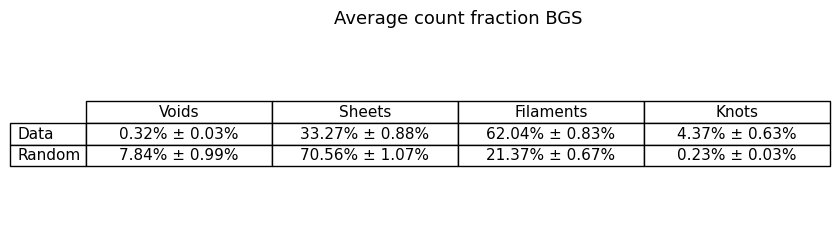

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle

structure_types = ['void', 'sheet', 'filament', 'knot']
type_to_index = {t: idx for idx, t in enumerate(structure_types)}

# Diccionarios para acumular todas las fracciones por tipo para cada roseta
real_fractions_all = {t: [] for t in structure_types}
rand_fractions_all = {t: [] for t in structure_types}

# Recorrer cada roseta
for i in range(20):
    with open(f'./typed_by_rosetta/df_typed_rosetta_{i}.pkl', 'rb') as f:
        df_typed_list = pickle.load(f)

    for source, container in [(False, real_fractions_all), (True, rand_fractions_all)]:
        fracs_by_type = {t: [] for t in structure_types}

        for j in range(100):
            df = df_typed_list[j]
            if df is None:
                continue

            df = df[df['RAN'] == source]
            total = len(df)
            if total == 0:
                continue

            for t in structure_types:
                count = np.sum(df['TYPE'] == t)
                frac = count / total
                fracs_by_type[t].append(frac)

        for t in structure_types:
            if len(fracs_by_type[t]) > 0:
                mean_frac = np.mean(fracs_by_type[t])
                container[t].append(mean_frac)

# Armar tabla transpuesta
data_row = []
rand_row = []

for t in structure_types:
    mean_real = np.mean(real_fractions_all[t])
    std_real = np.std(real_fractions_all[t], ddof=1)
    data_row.append(f"{mean_real*100:.2f}% ± {std_real*100:.2f}%")

    mean_rand = np.mean(rand_fractions_all[t])
    std_rand = np.std(rand_fractions_all[t], ddof=1)
    rand_row.append(f"{mean_rand*100:.2f}% ± {std_rand*100:.2f}%")

df_summary_transposed = pd.DataFrame([data_row, rand_row],
                                     index=["Data", "Random"],
                                     columns=["Voids", "Sheets", "Filaments", "Knots"])

# Exportar CSV y figura
out_dir = "desktop/CosmicWeb_BGS_ASTRA/07_resultados_100_random_vs_datos/100_random_tablas/general"
os.makedirs(out_dir, exist_ok=True)

df_summary_transposed.to_csv(f"{out_dir}/resumen_promedios_count_transpuesta.csv")

# Imagen
fig, ax = plt.subplots(figsize=(8, 2.5))
table = ax.table(cellText=df_summary_transposed.values,
                 rowLabels=df_summary_transposed.index,
                 colLabels=df_summary_transposed.columns,
                 loc='center',
                 cellLoc='center')

table.set_fontsize(11)
table.scale(1.2, 1.3)
ax.axis('off')
plt.title("Average count fraction BGS", fontsize=13, pad=10)
plt.savefig(f"{out_dir}/resumen_promedios_count_transpuesta.png", dpi=300, bbox_inches='tight')
plt.show()